# Annotating Cellines

This workbook is supposed to be run after the standard workflow.
It is demonstrating how to use the  annotation function to annotate the dataset that was runned through the standard worflow.

In this notebook, we will show how to use in-besca annotation to assign cell type to clusters.
We focus on immune celltype and demonstrate signature-scoring functions.


When it is possible to have a training dataset already annotated, one can use the auto-annot module.
Please refer to the corresponding tutorial.

In [1]:
import besca as bc
import numpy as np
import pandas as pd
import scanpy.api as sc
import matplotlib.pyplot as plt
from scipy import sparse, io
import os
import time
sc.logging.print_versions()

import logging
import seaborn as sns

# for standard processing, set verbosity to minimum
sc.settings.verbosity = 0  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80)
version = '2.8'
start0 = time.time()

/pstore/home/julienla/.conda/envs/besca_test/lib/python3.6/site-packages/scanpy/api/__init__.py:6: FutureWarning: 

In a future version of Scanpy, `scanpy.api` will be removed.
Simply use `import scanpy as sc` and `import scanpy.external as sce` instead.

  FutureWarning,


scanpy==1.4.5.post2 anndata==0.7.1 umap==0.3.10 numpy==1.17.5 scipy==1.4.1 pandas==0.24.1 scikit-learn==0.22.1 statsmodels==0.11.0 python-igraph==0.7.1 louvain==0.6.1


In [4]:
## this was creatied by the standard_workflow notebook.
#define standardized filepaths based on above input
root_path = os.getcwd()
analysis_name = 'standard_workflow_besca2.0'
results_folder = os.path.join(root_path, 'analyzed', analysis_name)




In [5]:

adata = sc.read_h5ad(os.path.join(results_folder, analysis_name + '.h5ad') )
adata


AnnData object with n_obs × n_vars = 9842 × 1341 
    obs: 'CELL', 'CONDITION', 'experiment', 'sample_type', 'storage_condition', 'donor', 'batch', 'percent_mito', 'n_counts', 'n_genes', 'leiden'
    var: 'ENSEMBL', 'SYMBOL', 'n_cells', 'total_counts', 'frac_reads'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

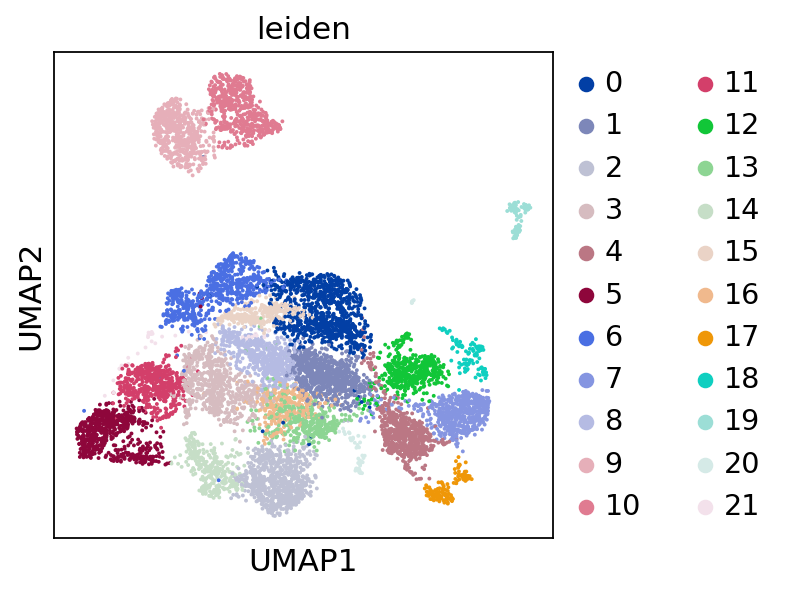

In [6]:
sc.pl.umap(adata, color= ['leiden'])

In [7]:
# ONe can load besca-provided signatures using the function below
signature_dict = bc.datasets.load_immune_signatures(refined=False)

signature_dict

{'lymphocyte': ['PTPRC'],
 'myeloid': ['S100A8', 'S100A9', 'CST3'],
 'Bcell': ['CD19', 'CD79A', 'MS4A1'],
 'Tcells': ['CD3ECD3G', 'CD3D'],
 'CD4': ['CD4'],
 'CD8': ['CD8ACD8B'],
 'NKcell': ['NKG7', 'GNLY', 'NCAM1'],
 'monocyte': ['CST3', 'CSF1R', 'ITGAM', 'CD14', 'FCGR3A', 'FCGR3B'],
 'macrophage': ['CD14',
  'IL1B',
  'LYZ    CD163   ITGAX',
  'CD68',
  'CSF1R',
  'FCGR3A']}

Additionaly it is possible to read an compute scanpy score using this function below.

If the gmt file is composed of combined signature (UP and DN), a common score will be computed: 
$$Total\_SCORE= Score_{UP} - Score_{DN}$$

In [9]:

gmt_file= os.path.split(root_path)[0] + '/besca/datasets/genesets/Immune.gmt'
bc.tl.sig.combined_signature_score(adata, gmt_file,
                             UP_suffix='_UP', DN_suffix='_DN', method='scanpy',
                             overwrite=False, verbose=False,
                             use_raw=True, conversion=None)

In [13]:
scores = [x for x in adata.obs.columns if 'scanpy' in x]

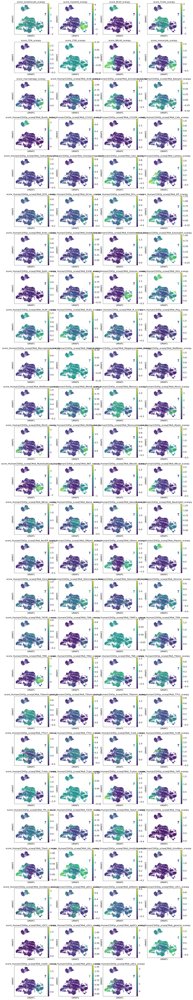

In [14]:
sc.pl.umap(adata, color= scores)

# Immune signatures for specific sub-populations

In [15]:
 ## PROVIDED WITH BESCA
gmt_file_IMM= os.path.split(root_path)[0] + '/besca/datasets/genesets/HumanCD45p_scseqCMs6.gmt'
bc.tl.sig.combined_signature_score(adata, gmt_file_IMM)


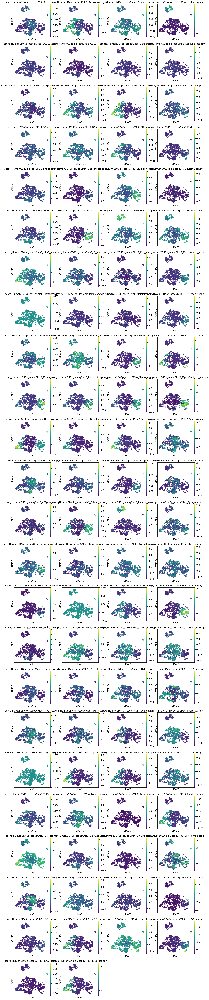

In [16]:
scores = [x for x in adata.obs.columns if 'CD45' in x]
sc.pl.umap(adata, color= scores, color_map = 'viridis')

# Automated annotation

We encompass some automatated decision-tree annotation for PBMCs, TILCs and the immuno-compartment within single cell data.

This is an aid to start ther annotation and annotation can then be further refined. It was tested mainly on PBMCs and oncology (ie. tumor) related samples.


In [17]:
mymarkers  = bc.datasets.load_immune_signatures()

In [18]:
setName = 'HumanCD45p_scseqCMs6'
# Fract_pos was exported by BESCA in the standard worflow test
f=pd.read_csv(results_folder + "/labelings/leiden/fract_pos.gct",sep="\t",skiprows=2)
df=bc.tl.sig.score_mw(f,mymarkers)
myc=np.median(df.loc[setName+'_Ubi',:]*2/3)


/pstore/home/julienla/.conda/envs/besca_test/lib/python3.6/site-packages/scipy/stats/stats.py:6415: RuntimeWarning:

divide by zero encountered in double_scalars



In [19]:
cNames=bc.tl.sig.make_anno(df,myc,setName,f, 0.3)
adata=bc.tl.sig.add_anno(adata,cNames, 'leiden')

... storing 'cell_names' as categorical
... storing 'cell_group' as categorical
... storing 'scell_group' as categorical
... storing 'sscell_group' as categorical


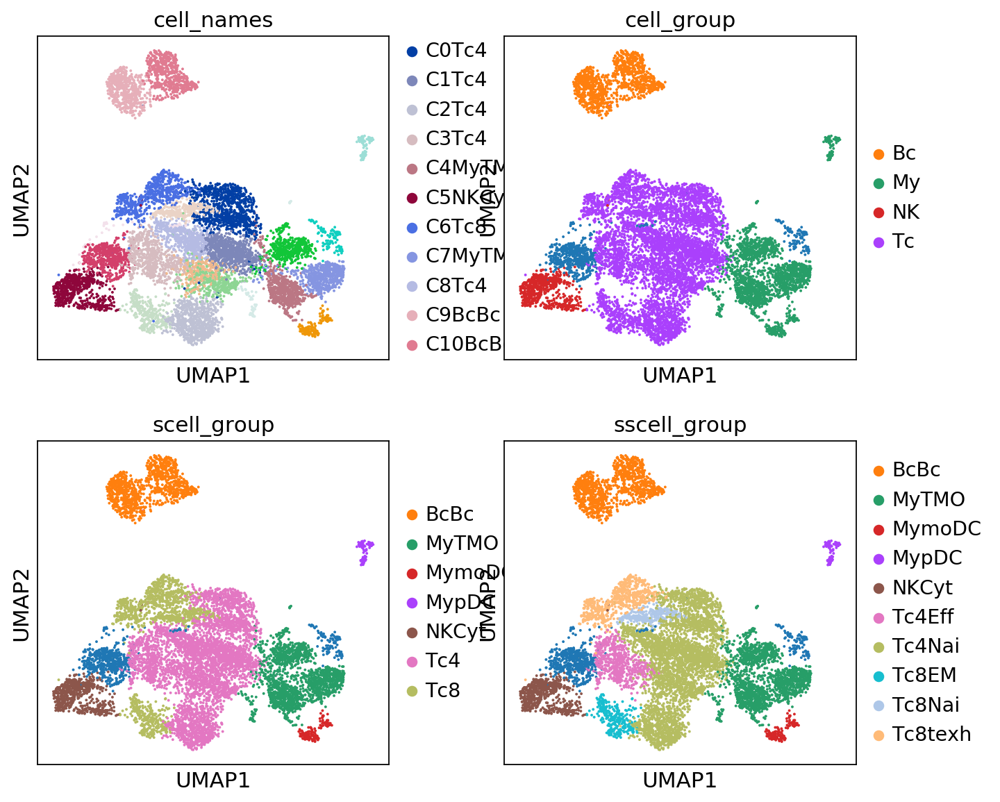

In [20]:
sc.pl.umap(adata, color= ['cell_names', 'cell_group', 'scell_group', 'sscell_group'], ncols = 2)